In [3]:
import pickle
import os

In [27]:
def load_pickle(path):
    with open(path, 'rb') as fp:
        _ = pickle.load(fp)
    # for element in _:
    #     print(element)
    # print("\n \n \n")
    return _

In [28]:
dir_path = "../../data/pickles/MobileNet_train_all_test_all"
for file in os.listdir(dir_path):
    p = load_pickle(f"{dir_path}/{file}")
    #print(f"\n{p}\n")

In [60]:
P_R_F1_global_MobileNet_input_all = load_pickle('/home/acarlier/code/project_ornithoScope/src/data/pickles/MobileNet_train_all_test_all/prediction_TP_FP_FN_MobileNet_input_all.p')
bad_images = []
for img in P_R_F1_global_MobileNet_input_all:
    for i in range(len(img["score"])): 
        if img["score"][i] < 0.75:
            bad_images.append(img)
            print(img["img_name"], img["predictions_name"][i], img["score"][i])

task_20210418_UPS/20210418-172654_(13.0).jpg ECUROU 0.74045813
task_21-01-2021/2021-01-21-12-13-40.jpg MESCHA 0.6057325
task_2021_11_03-04_cescau4/2021-11-03-15-45-25.jpg SITTOR 0.7226283
task_20210611_Lab/2021-06-11-15-45-20.jpg MESCHA 0.6325082
task_05-01-2021/2021-01-05-17-25-00.jpg MESNON 0.6382978
task_21-01-2021/2021-01-21-14-07-37.jpg MESBLE 0.74708474
task_05-01-2021/2021-01-05-16-09-28.jpg SITTOR 0.7465891
task_2021-03-01_15/20210301-150327_(17.0).jpg MESCHA 0.5804101
task_20210227/20210227-115254_(5.0).jpg VEREUR 0.65043515
task_20210523_UPS/20210523-174153_(55.0).jpg TOUTUR 0.5556923
task_2021-03-01_09/20210301-090513_(6.0).jpg PINARB 0.5491342
task_20210205/20210205-145229_02(75.0).jpg MESCHA 0.7056618
task_2021_11_03-04_cescau4/2021-11-04-08-03-28.jpg MESNON 0.50143635
task_2021-03-01_12/20210301-123109_(5.0).jpg PINARB 0.5177843
task_20210624_balacet/2021-06-24-13-49-41.jpg ACCMOU 0.6207758
task_20210624_balacet/2021-06-24-06-54-57.jpg MULGRI 0.52713895
task_20211204_Orlu

In [63]:
def round_score(bad_images):
    for img in bad_images: 
        for score in img['score']:
            score = round(score,3)
    return bad_images

In [64]:
bad_images_ = round_score(bad_images)

In [65]:
bad_images_

[{'img_name': 'task_20210418_UPS/20210418-172654_(13.0).jpg',
  'predictions_id': [10],
  'predictions_name': ['ECUROU'],
  'score': [0.74045813],
  'true_id': [10.0],
  'true_name': [],
  'TP': ['ECUROU'],
  'FN': [],
  'FP': []},
 {'img_name': 'task_21-01-2021/2021-01-21-12-13-40.jpg',
  'predictions_id': [0],
  'predictions_name': ['MESCHA'],
  'score': [0.6057325],
  'true_id': [0.0],
  'true_name': [],
  'TP': ['MESCHA'],
  'FN': [],
  'FP': []},
 {'img_name': 'task_2021_11_03-04_cescau4/2021-11-03-15-45-25.jpg',
  'predictions_id': [1],
  'predictions_name': ['SITTOR'],
  'score': [0.7226283],
  'true_id': [1.0],
  'true_name': [],
  'TP': ['SITTOR'],
  'FN': [],
  'FP': []},
 {'img_name': 'task_20210611_Lab/2021-06-11-15-45-20.jpg',
  'predictions_id': [0],
  'predictions_name': ['MESCHA'],
  'score': [0.6325082],
  'true_id': [0.0],
  'true_name': [],
  'TP': ['MESCHA'],
  'FN': [],
  'FP': []},
 {'img_name': 'task_05-01-2021/2021-01-05-17-25-00.jpg',
  'predictions_id': [3],
 

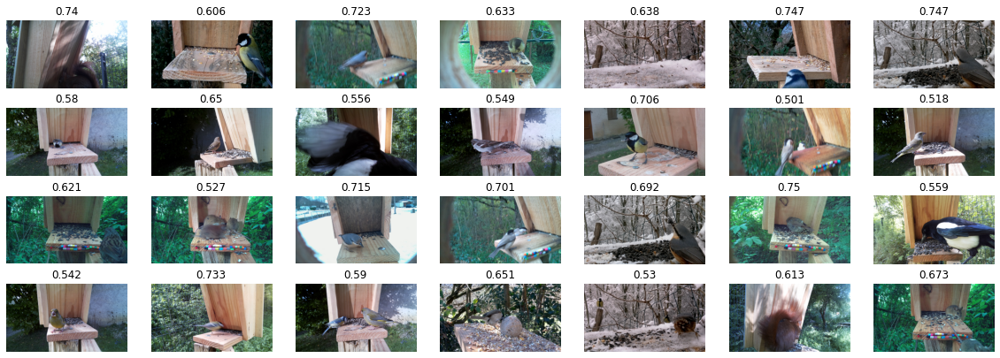

In [66]:
import numpy as np
import matplotlib.pyplot as plt

_ = bad_images[:28]
w = 20
h = 20
fig = plt.figure(figsize=(20, 7))
columns = 7
rows = 4

# prep (x,y) for extra plotting
xs = np.linspace(0, 2*np.pi, 60)  # from 0 to 2pi
ys = np.abs(np.sin(xs))           # absolute of sine

# ax enables access to manipulate each of subplots
ax = []

for i in range(columns*rows):
    img = Image.open(f"/home/acarlier/code/data_ornithoscope/p0133_bird_data/raw_data/{_[i]['img_name']}")
    # create subplot and append to ax
    ax.append( fig.add_subplot(rows, columns, i+1, label =_[i]["score"]) )
    ax[-1].set_title(round(min(_[i]["score"]),3))  # set title
    plt.imshow(img)
    plt.axis('off')


# do extra plots on selected axes/subplots
# note: index starts with 0
ax[2].plot(xs, 3*ys)
ax[19].plot(ys**2, xs)
plt.savefig("/home/acarlier/code/project_ornithoScope/src/data/imgs/img_plot/bad_imgs/0_28.png", bbox_inches='tight')
plt.show()  # finally, render the plot

/tmp/ipykernel_385391/1886653347.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots()


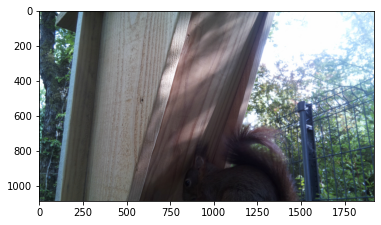

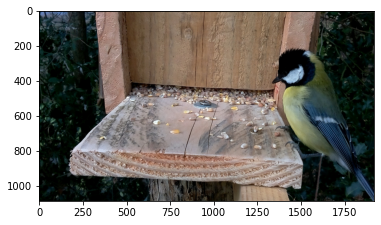

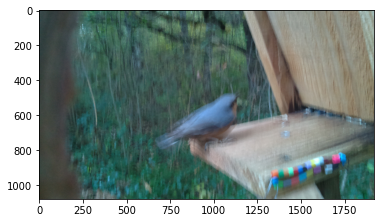

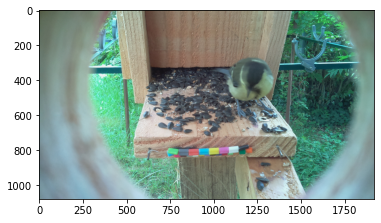

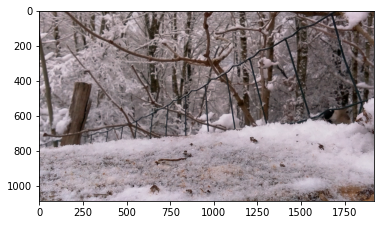

...

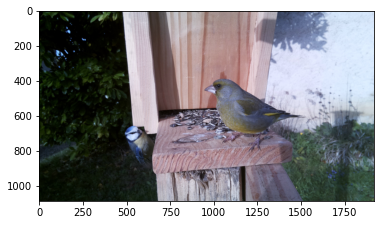

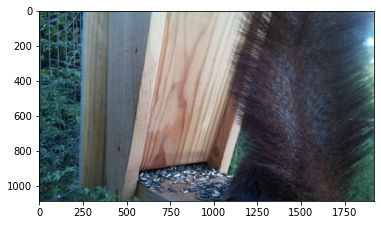

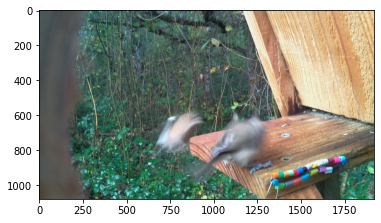

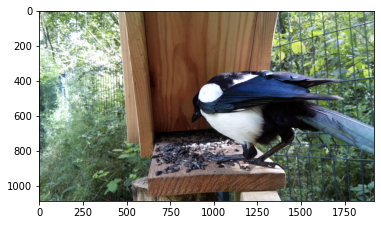

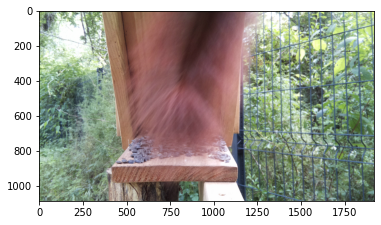

Error in callback <function flush_figures at 0x7fd5323bea60> (for post_execute):


KeyboardInterrupt: 

In [34]:
from PIL import Image
import matplotlib.pyplot as plt
for img in bad_images[:50]:
    path = f"/home/acarlier/code/data_ornithoscope/p0133_bird_data/raw_data/{img['img_name']}"
    im = Image.open(path)
    fig, ax = plt.subplots()
    #ax.imshow(im)
